In [1]:
import sys 
import re
import random 
import os 

import pandas as pd 
from PIL import Image
import numpy as np
import layoutparser as lp 

pattern = re.compile(r'(\S{6})\+')
random.seed(425)
sys.path.append("../../src")

from scienceparseplus.datamodel import *
from scienceparseplus.datasets.docbank import *

In [2]:
from scienceparseplus.constants import UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP

In [3]:
def convert_row_to_rectbox(row):
    rectbox = lp.TextBlock(
        lp.Rectangle(row["x_1"], row["y_1"], row["x_2"], row["y_2"]),
        text=row["text"],
        type=row["category"],
    )
    return rectbox

In [4]:
# Load the raw dataset

dataset = DocBankDataset('data/DocBank/')

# Load the detected blocks 

blocks = pd.read_csv('data/DocBank/grouped/blocks.csv')
files = pd.read_csv('data/DocBank/grouped/filenames.csv', index_col=0)
files = files.set_index('filename')

In [5]:
# Load the processed dataset 

subset = 'test'
with open(f"data/DocBank/grouped-v3.1/{subset}-token.json", "r") as fp: 
    grouped = json.load(fp)
    
with open(f"data/DocBank/indexed_files/500K_{subset}.txt", "r") as fp:
    all_files = fp.read()
    all_files = all_files.strip().split("\n")

61.tar_1405.4142.gz_spoof_final_8
Original + Blocks				After Processing 				Original


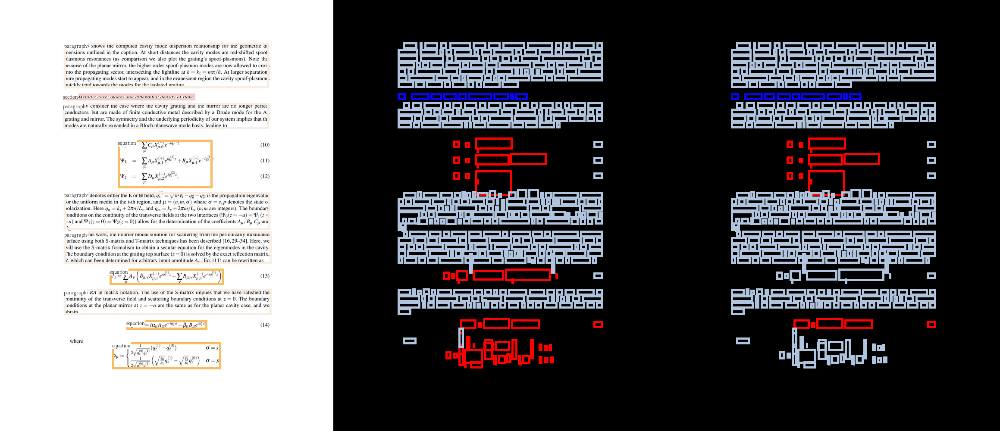

148.tar_1707.01770.gz_riemann6_26
Original + Blocks				After Processing 				Original


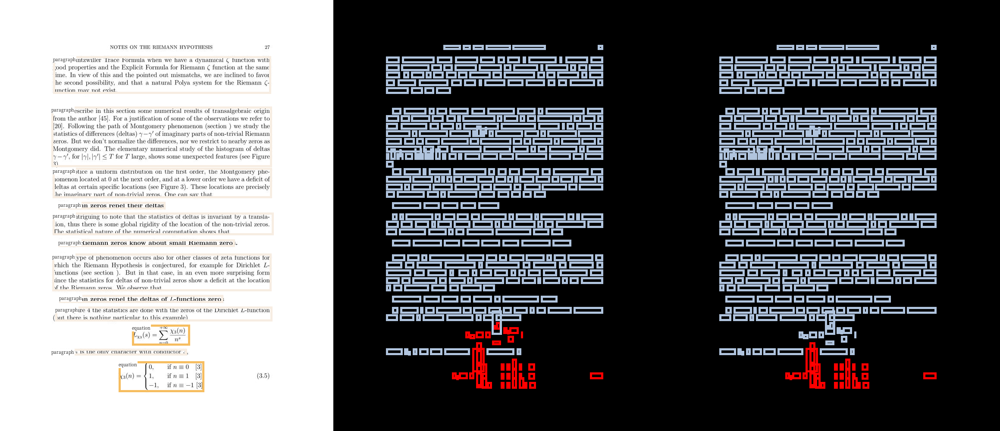

108.tar_1408.5801.gz_paper_2
Original + Blocks				After Processing 				Original


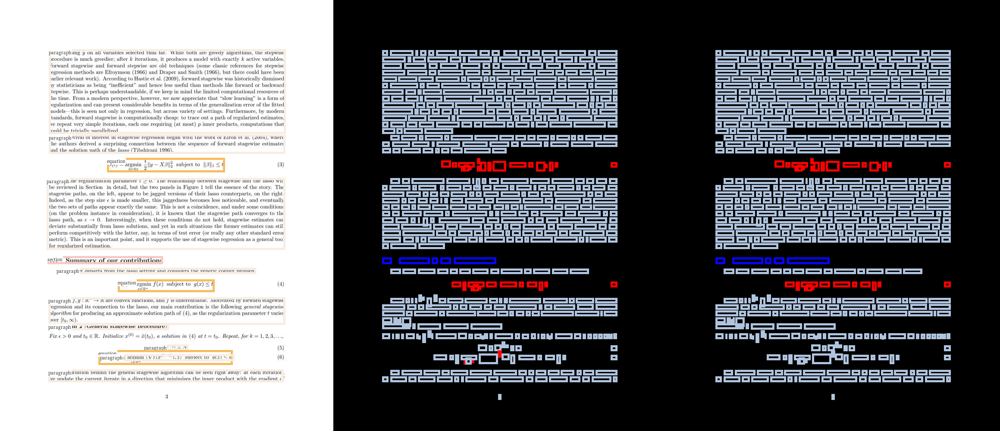

153.tar_1707.04108.gz_emnlp2017_5
Original + Blocks				After Processing 				Original


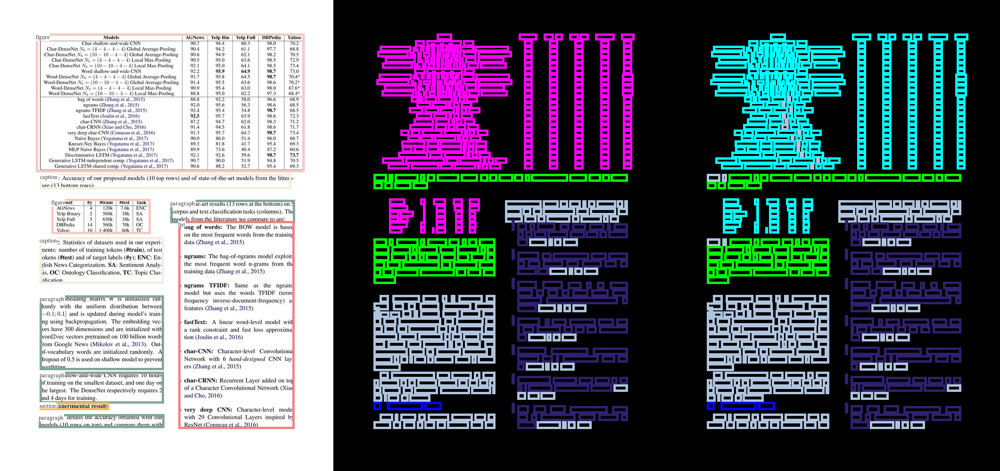

175.tar_1708.02890.gz_ldtrnd7_10
Original + Blocks				After Processing 				Original


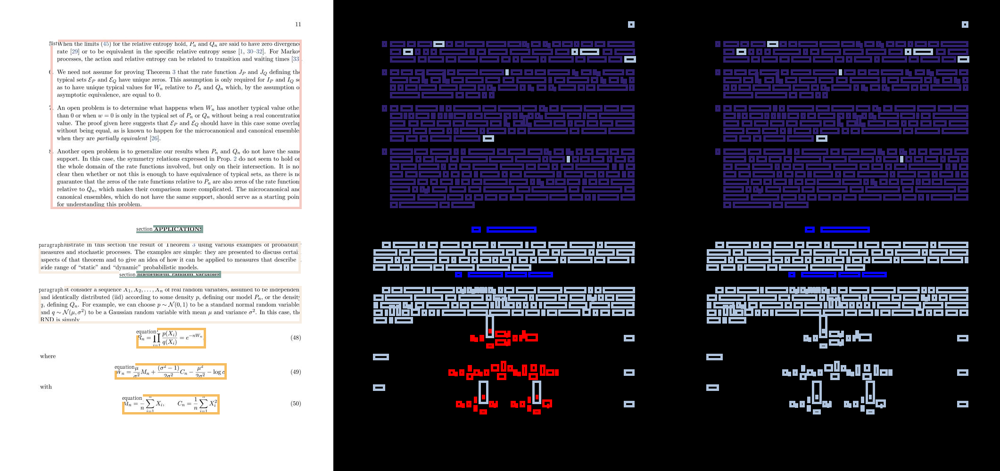

217.tar_1611.02986.gz_paper_10
Original + Blocks				After Processing 				Original


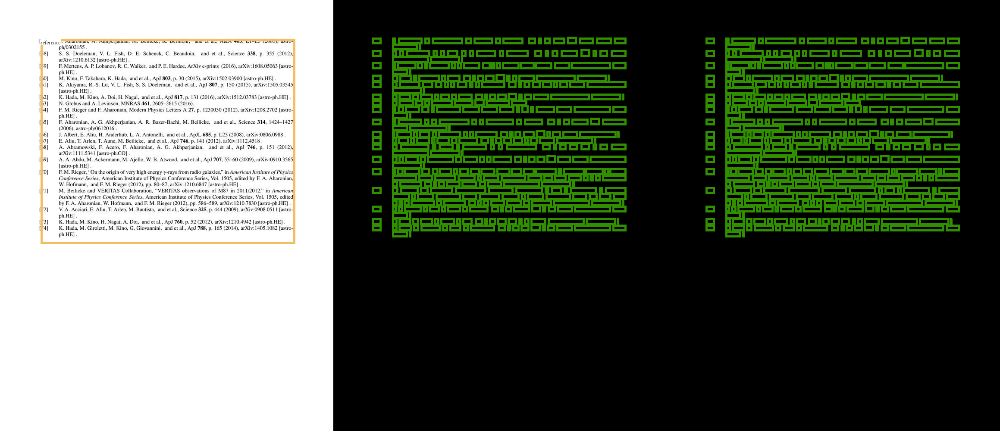

40.tar_1603.01690.gz_ovimm-tian_13
Original + Blocks				After Processing 				Original


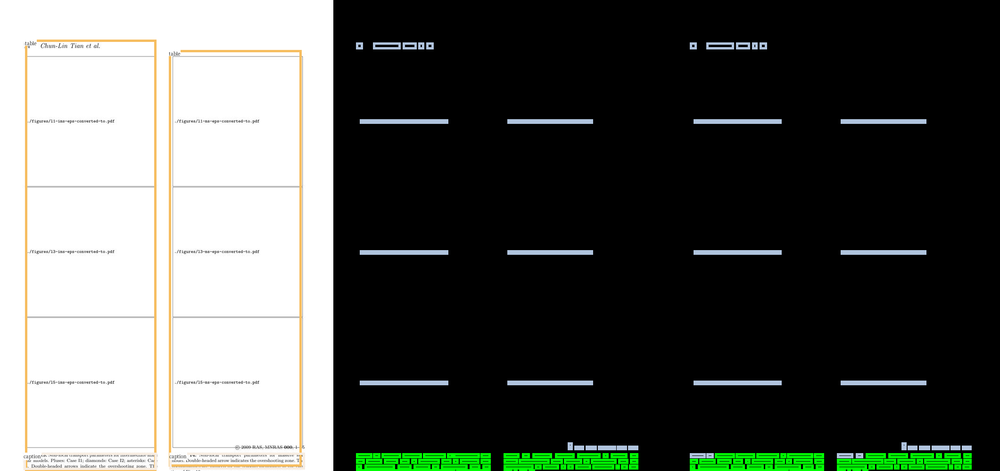

171.tar_1609.02884.gz_mbpol_15
Original + Blocks				After Processing 				Original


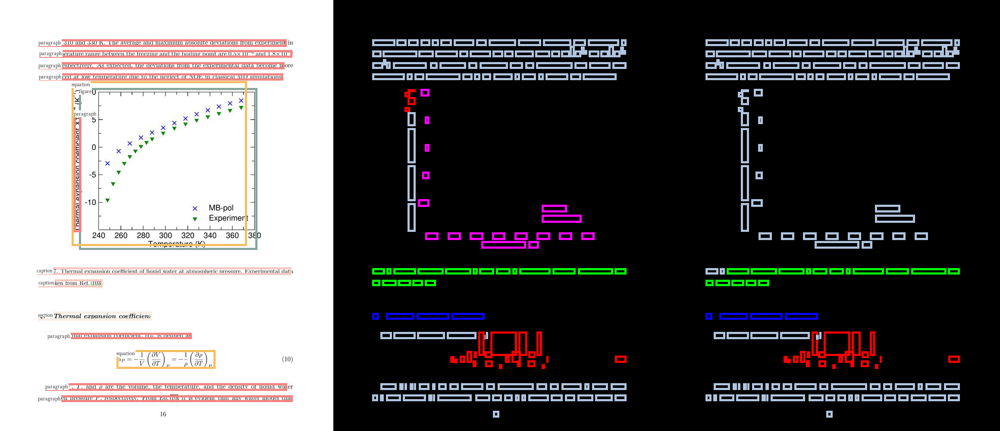

180.tar_1708.04816.gz_TASL_03408_Directional_Laplacian_2
Original + Blocks				After Processing 				Original


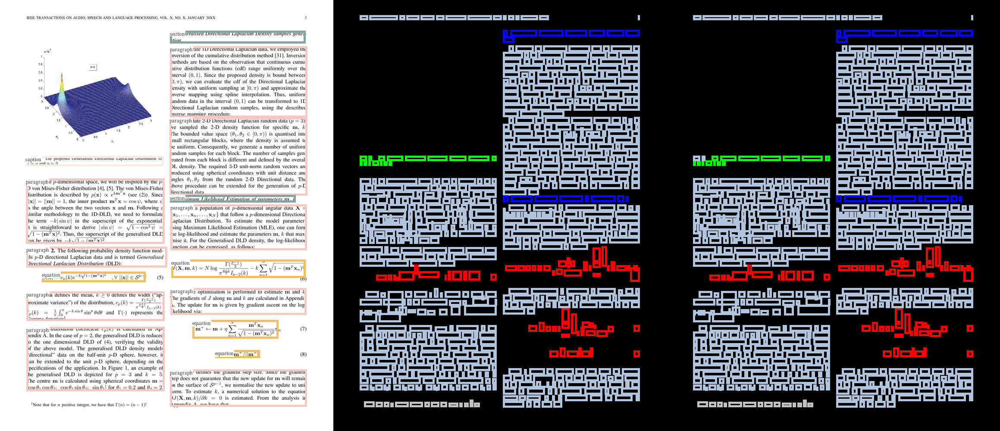

149.tar_1608.02495.gz_ogws_8_32
Original + Blocks				After Processing 				Original


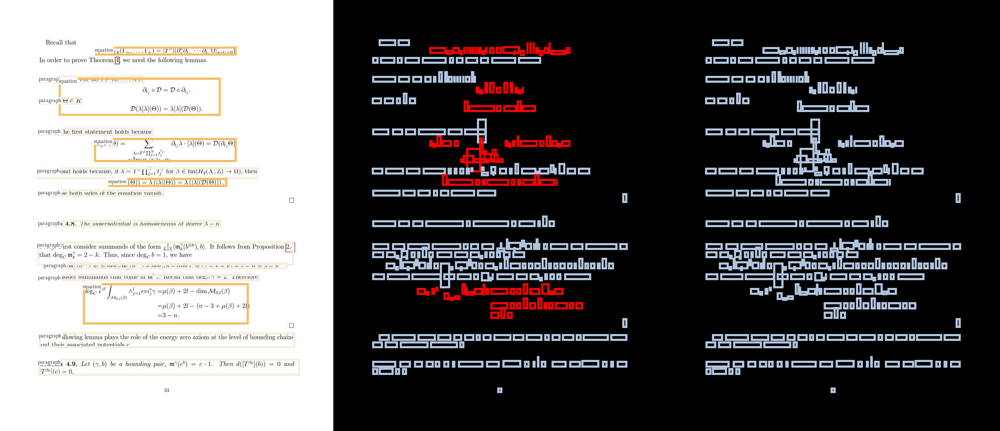

112.tar_1507.05789.gz_NewKindCA_39
Original + Blocks				After Processing 				Original


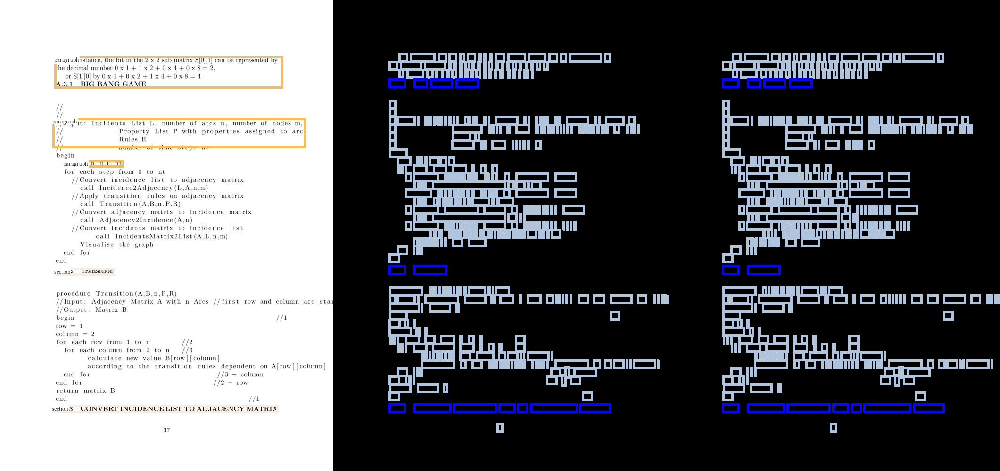

160.tar_1707.07026.gz_global_conservation_Cooper_frye_8
Original + Blocks				After Processing 				Original


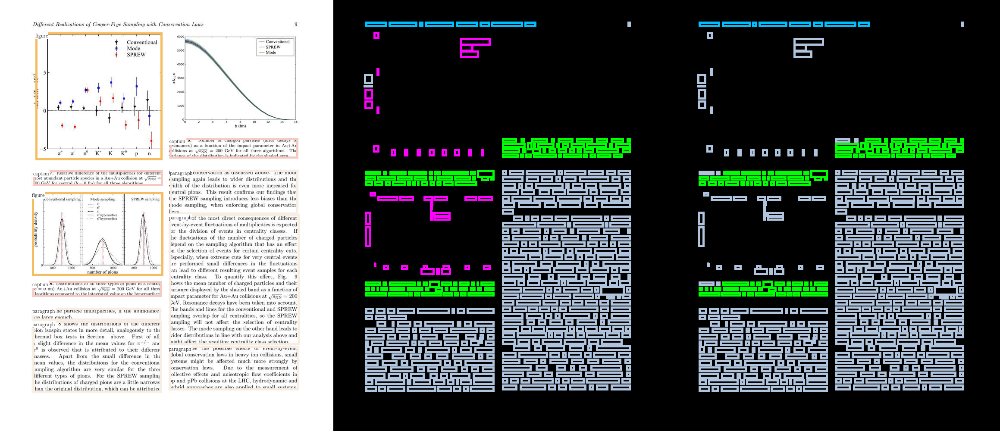

240.tar_1710.08088.gz_QED-DD-1221_5
Original + Blocks				After Processing 				Original


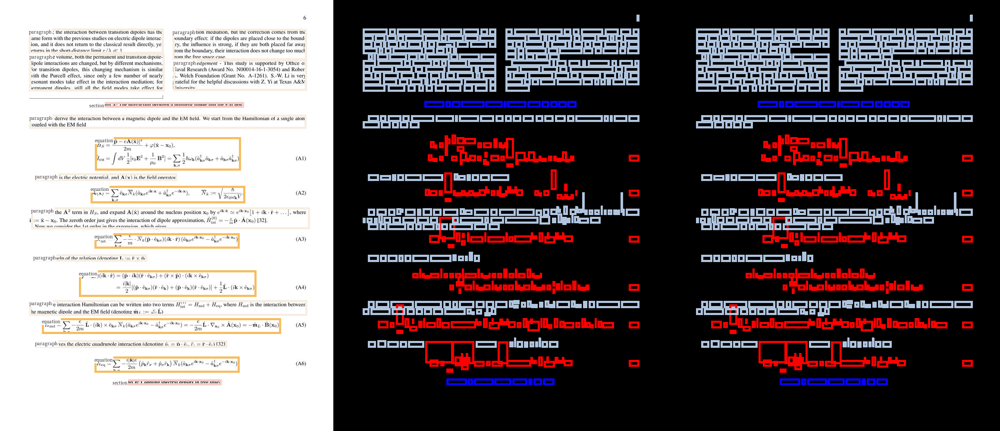

136.tar_1706.07136.gz_MS_PID_v1_4
Original + Blocks				After Processing 				Original


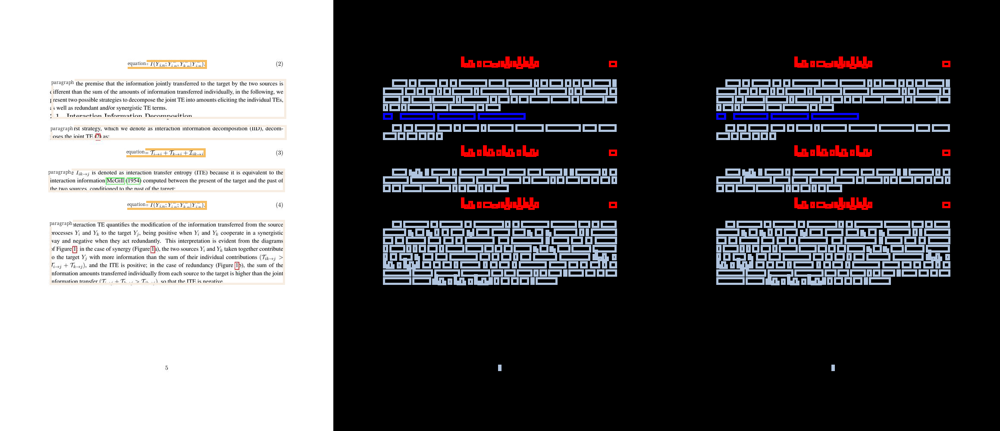

34.tar_1503.01325.gz_TopCouplings_0
Original + Blocks				After Processing 				Original


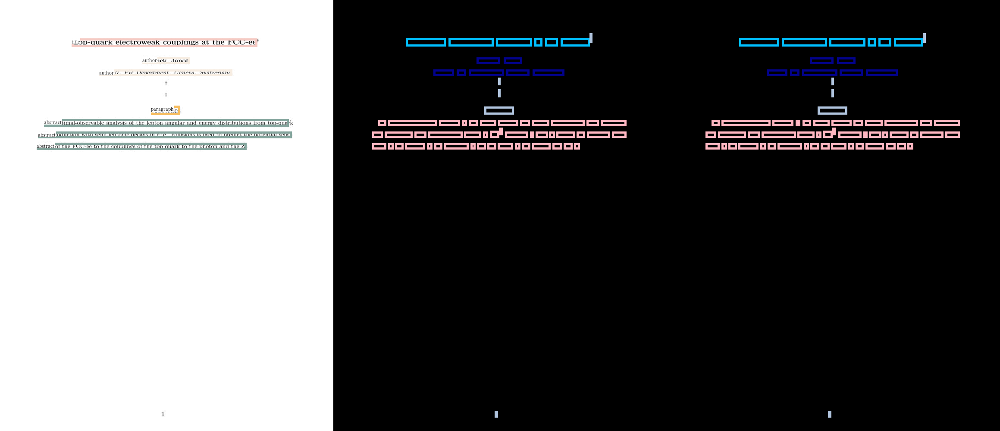

152.tar_1805.12466.gz_prop_replacement_11
Original + Blocks				After Processing 				Original


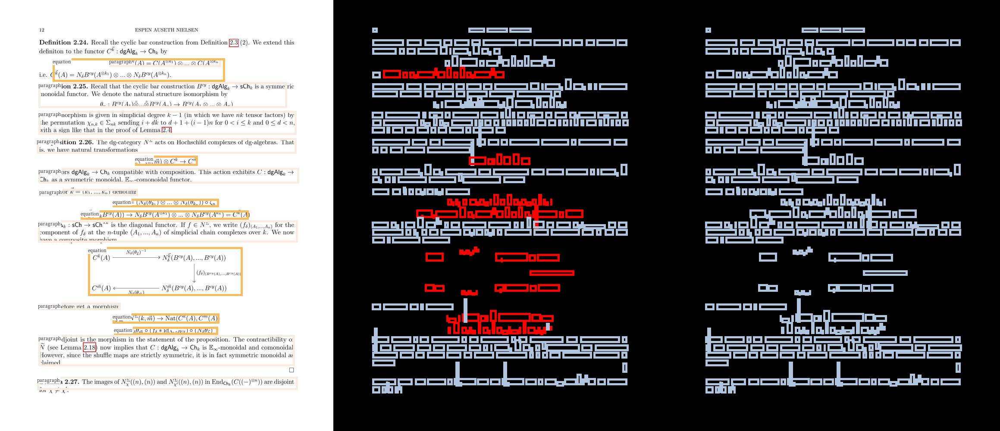

134.tar_1410.3814.gz_IteratesofGenericPolynomialsandRationalFunctions_8
Original + Blocks				After Processing 				Original


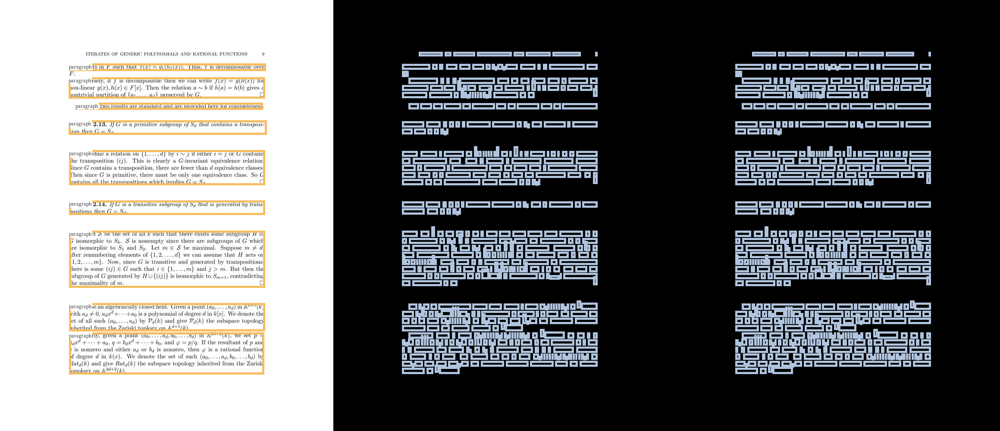

222.tar_1710.00823.gz_synthetic_cluster_14
Original + Blocks				After Processing 				Original


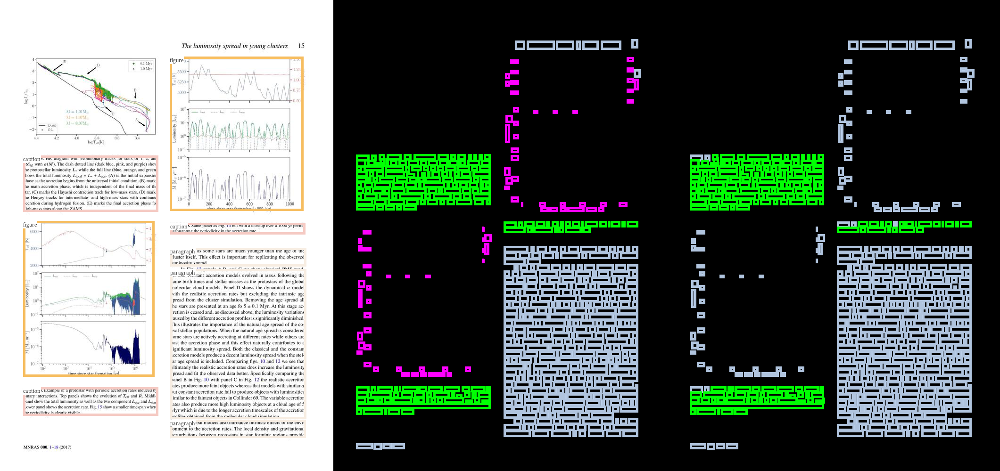

84.tar_1506.00124.gz_einstein_algebras_10
Original + Blocks				After Processing 				Original


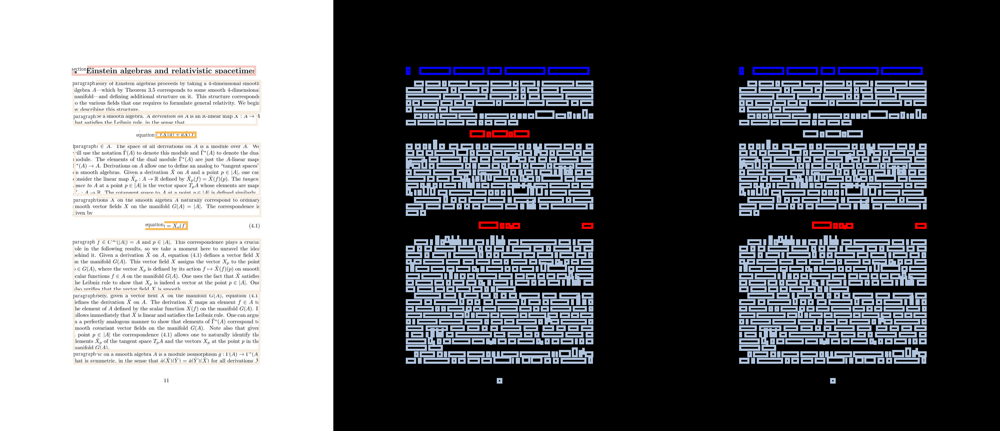

211.tar_1512.07607.gz_manuscript_aoas_revised_12
Original + Blocks				After Processing 				Original


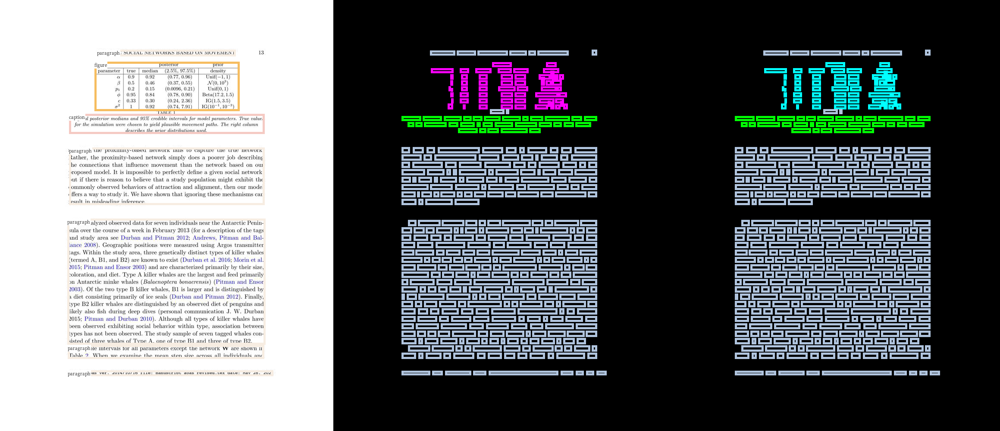

In [12]:
_cvt_label = {int(key):val for key, val in grouped['labels'].items()}
_names = []
_num_tokens = []
for idx in random.sample(range(len(all_files)), 20):
    print(all_files[idx].replace('.txt',''))
    _names.append(all_files[idx].replace('.txt',''))


    i = dataset.all_index.index(all_files[idx].replace('.txt',''))

    name, layout, image = dataset[i]
    block_layout = lp.Layout(blocks[blocks.file_id == files.loc[name].iloc[0]].apply(convert_row_to_rectbox, axis=1).to_list())
    block_layout = block_layout.scale((image.size[0]/1000, image.size[1]/1000))
    
    idx = grouped['files'].index(all_files[idx])
    p = grouped['data'][idx]
    grouped_layout = [lp.TextBlock(lp.Rectangle(*p['bbox'][i]), text=p['words'][i], type=_cvt_label[p['labels'][i]]) for i in range(len(grouped['data'][idx]['words']))]    
    grouped_layout = lp.Layout(grouped_layout).scale((image.size[0]/1000, image.size[1]/1000))
    
    viz = lp.draw_box(Image.new('RGB', (image.size[0]*2, image.size[1])), 
                      grouped_layout, color_map=UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP)
    viz = lp.draw_box(viz, [ele.shift((image.size[0],0)) for ele in layout], color_map=UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP)
    
    viz = Image.fromarray(np.hstack([np.array(image), np.array(viz)]))
    viz = lp.draw_box(viz, [ele.set(id=ele.type) for ele in block_layout], show_element_id=True, id_font_size=10)
    
    _num_tokens.append(len(layout))
    print("Original + Blocks\t\t\t\t" + "After Processing \t\t\t\t" + "Original")
    display(viz)

172.tar_1609.03198.gz_denjoy_5
Original + Blocks				After Processing 				Original


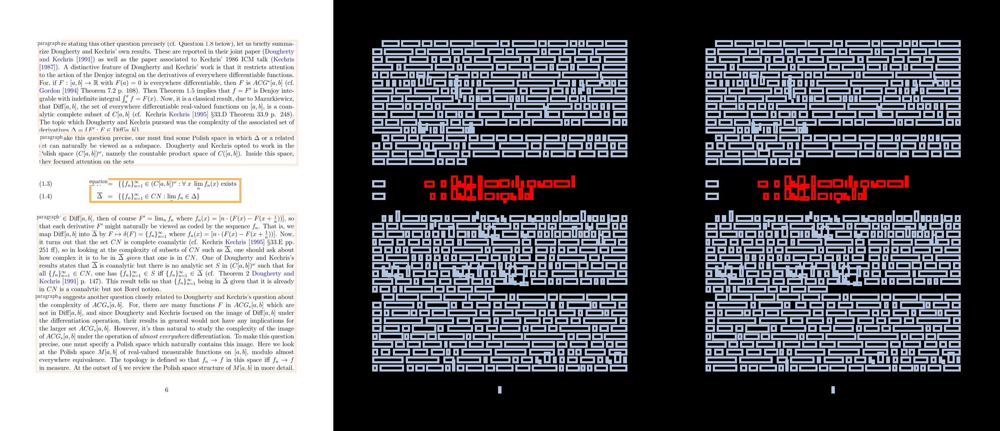

34.tar_1602.08337.gz_Tech_Rep_Multicentric_calc_Riesz_proj_33
Original + Blocks				After Processing 				Original


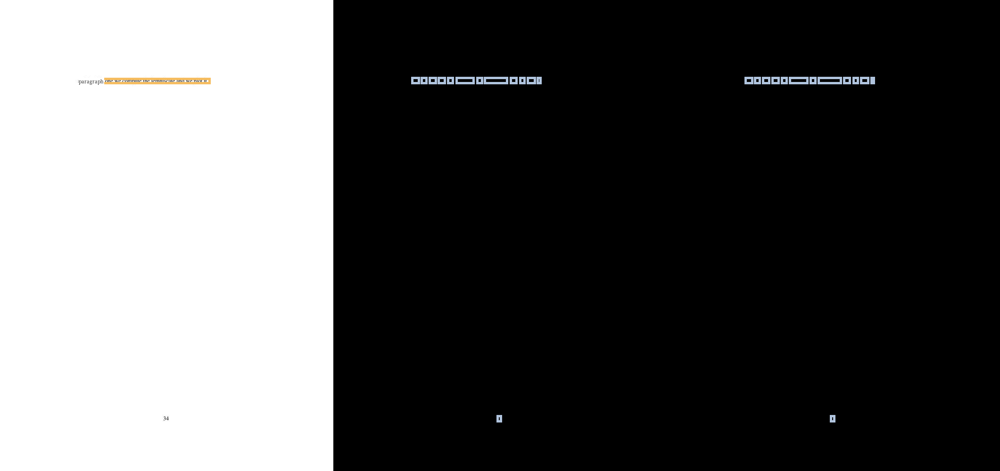

193.tar_1511.08355.gz_26_3_EKF_estimation_scenarios_25
Original + Blocks				After Processing 				Original


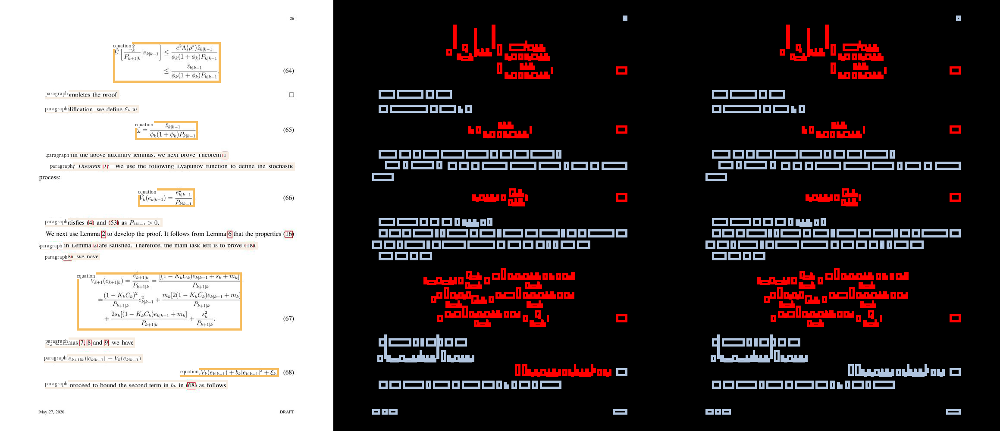

95.tar_1804.02575.gz_A_classification_of_maximally_symmetric_surfaces_in_the_3-dimensional_torus_0
Original + Blocks				After Processing 				Original


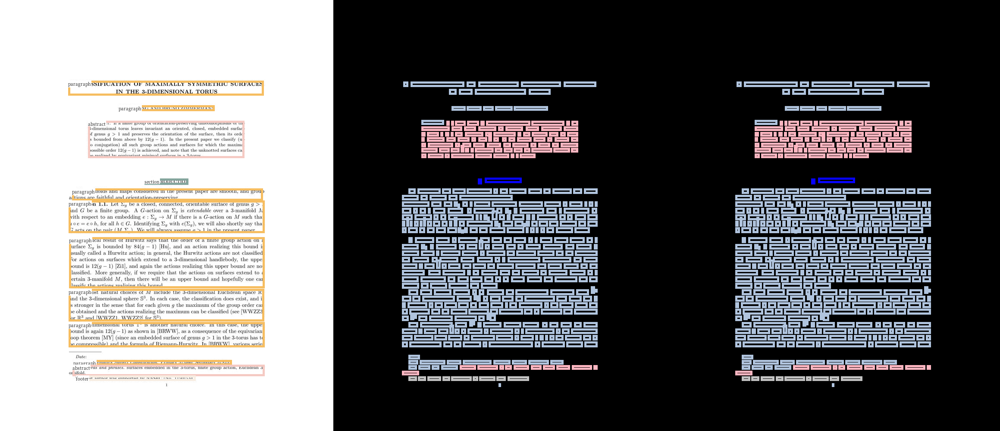

85.tar_1506.00868.gz_specification_V2_0
Original + Blocks				After Processing 				Original


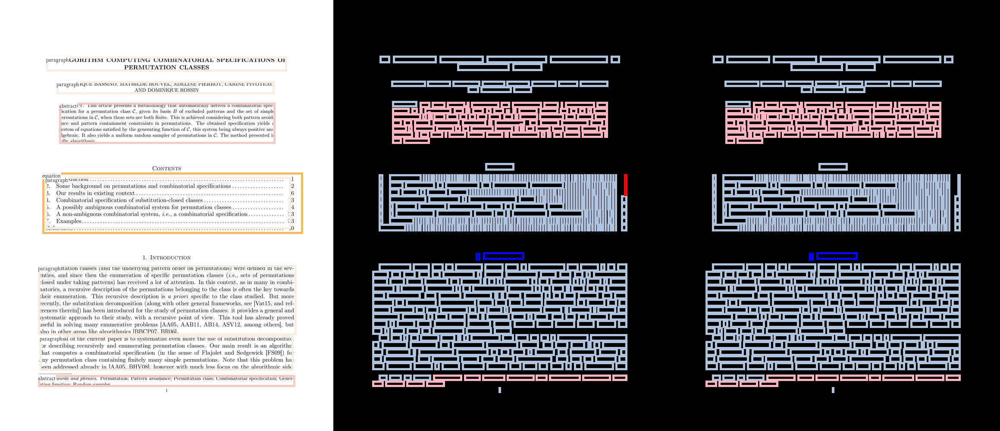

18.tar_1801.07406.gz_ms_ywmao_arXiv_6
Original + Blocks				After Processing 				Original


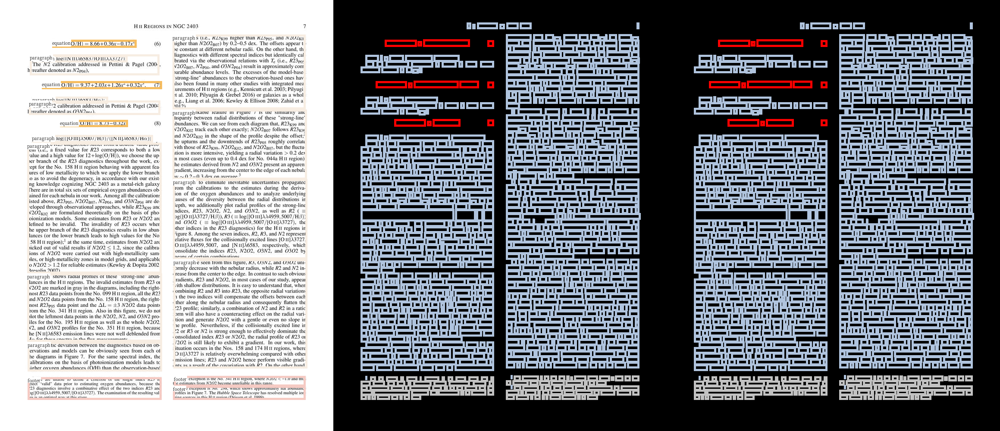

225.tar_1808.01446.gz_main_5
Original + Blocks				After Processing 				Original


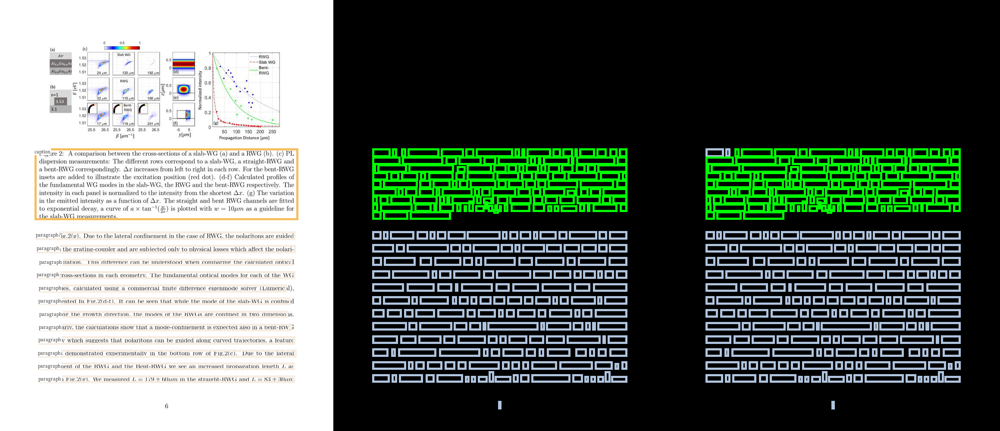

8.tar_1801.03354.gz_camera_3
Original + Blocks				After Processing 				Original


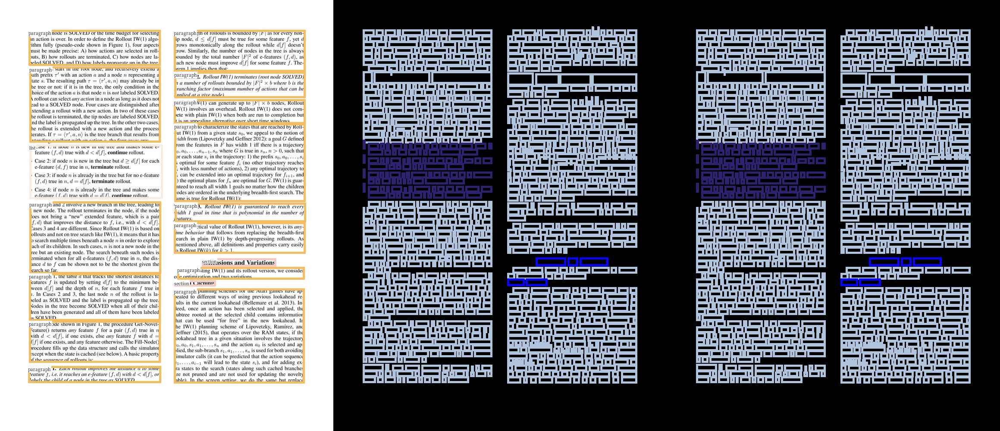

175.tar_1511.00382.gz_symsetv9_21
Original + Blocks				After Processing 				Original


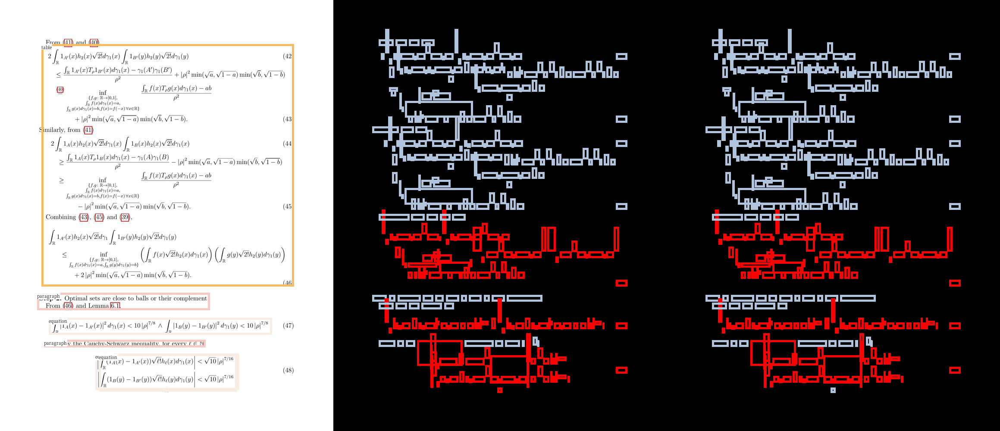

10.tar_1401.6263.gz_twisty_itsy_bitsy_25
Original + Blocks				After Processing 				Original


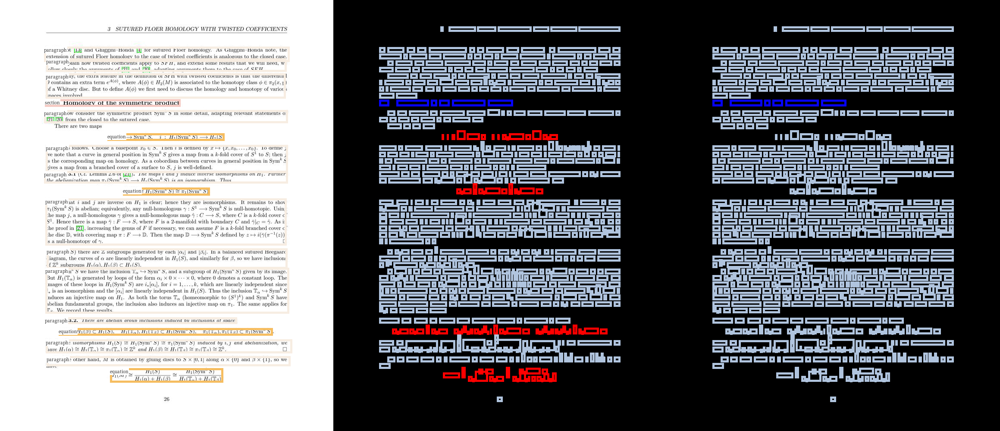

179.tar_1708.04609.gz_orbits_v7_7
Original + Blocks				After Processing 				Original


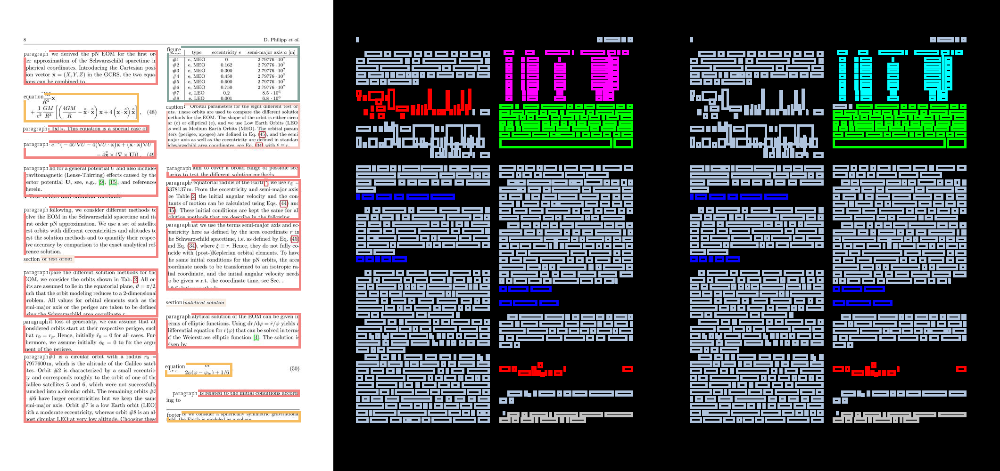

280.tar_1809.09996.gz_vg_16
Original + Blocks				After Processing 				Original


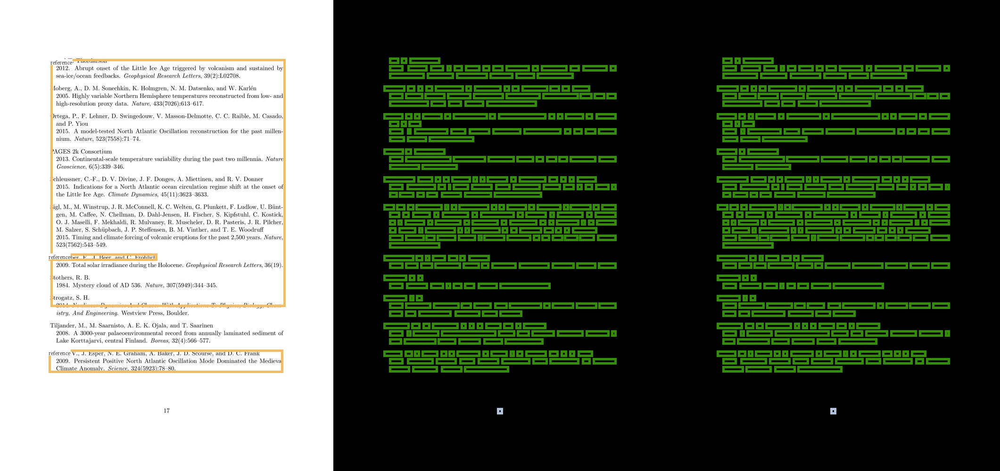

27.tar_1702.02288.gz_NataliaCarvalhoLowTemperatureMicrowave_b_4
Original + Blocks				After Processing 				Original


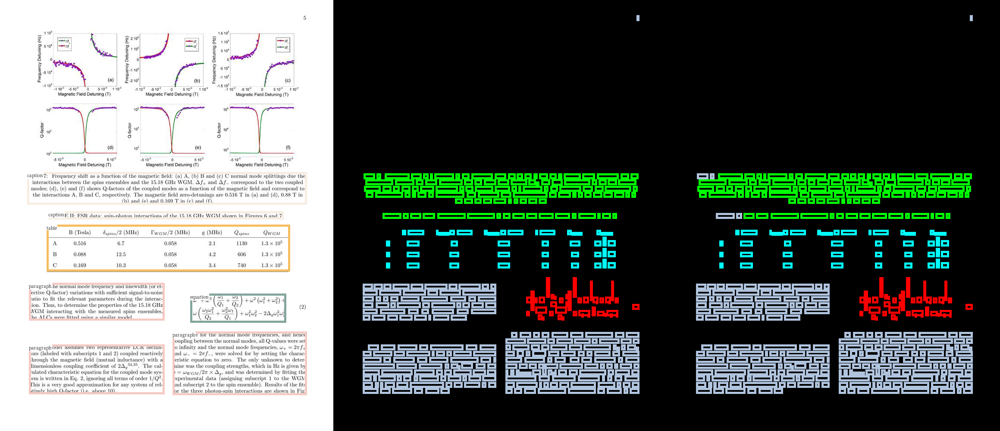

102.tar_1804.05168.gz_jl1_36
Original + Blocks				After Processing 				Original


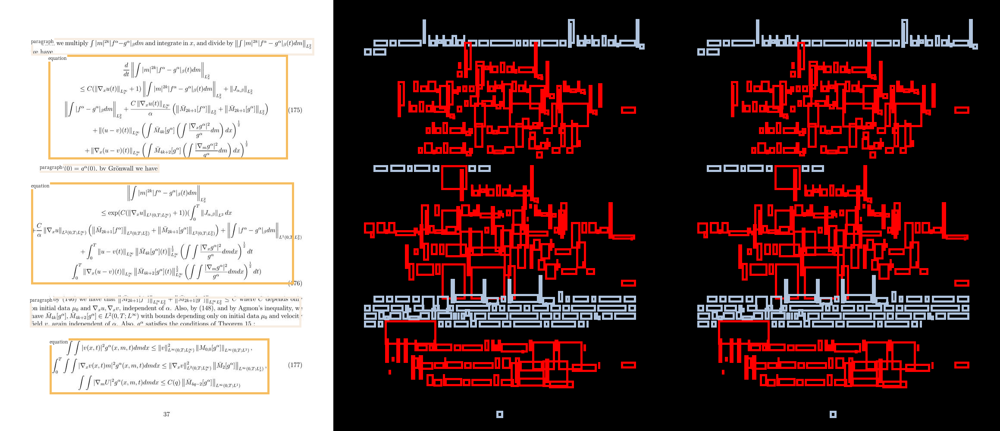

227.tar_1710.02915.gz_On_the_existence_of_non-isentropic_rotating_gaseous_stars_15
Original + Blocks				After Processing 				Original


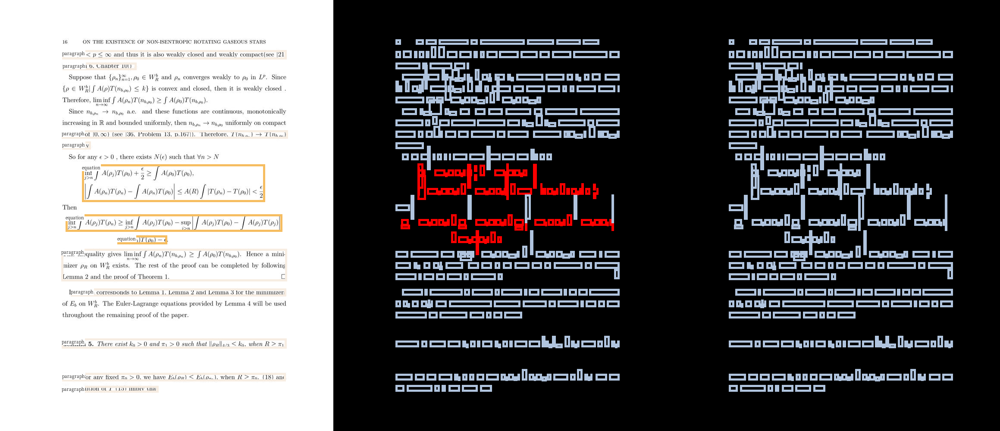

91.tar_1407.4967.gz_m140718_6
Original + Blocks				After Processing 				Original


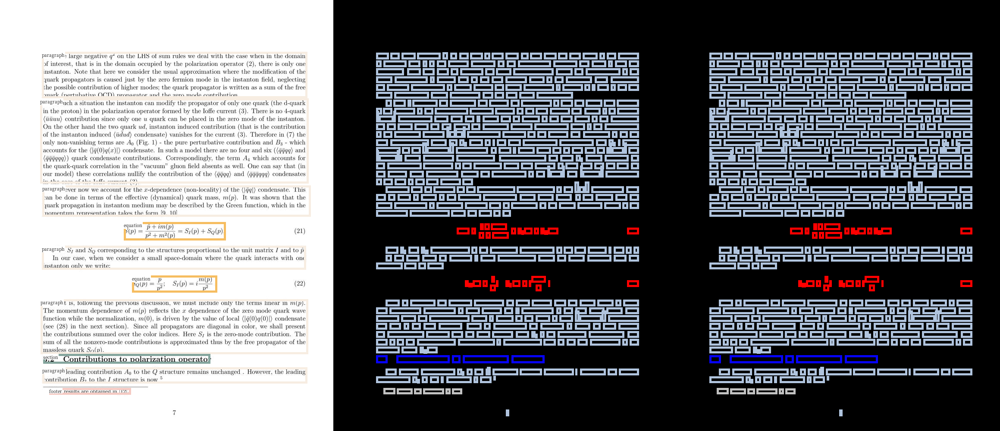

160.tar_1707.07151.gz_HetNet_secure_1
Original + Blocks				After Processing 				Original


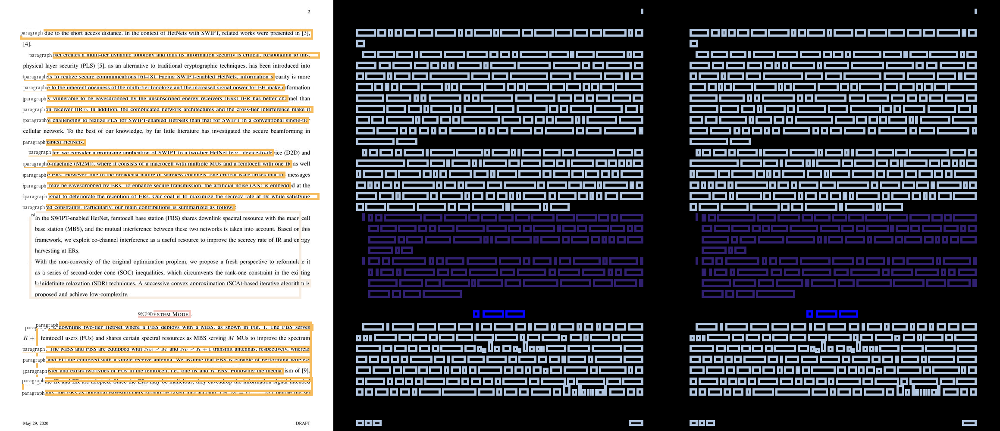

51.tar_1603.06705.gz_superdet_v2.991_23
Original + Blocks				After Processing 				Original


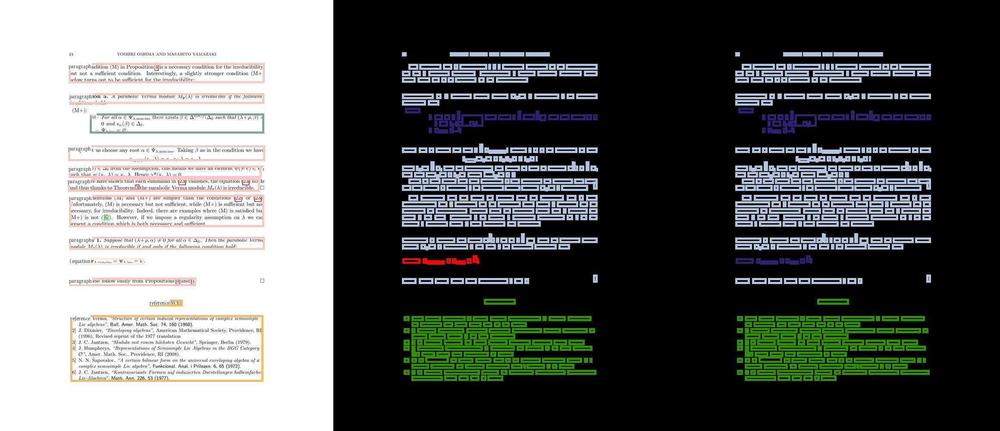

34.tar_1702.05575.gz_zhang17_18
Original + Blocks				After Processing 				Original


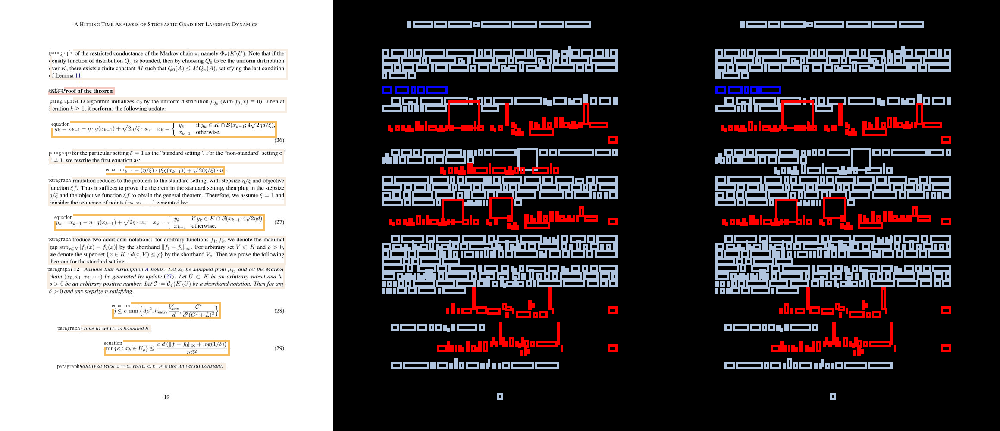

168.tar_1806.05273.gz_arxiv02_6
Original + Blocks				After Processing 				Original


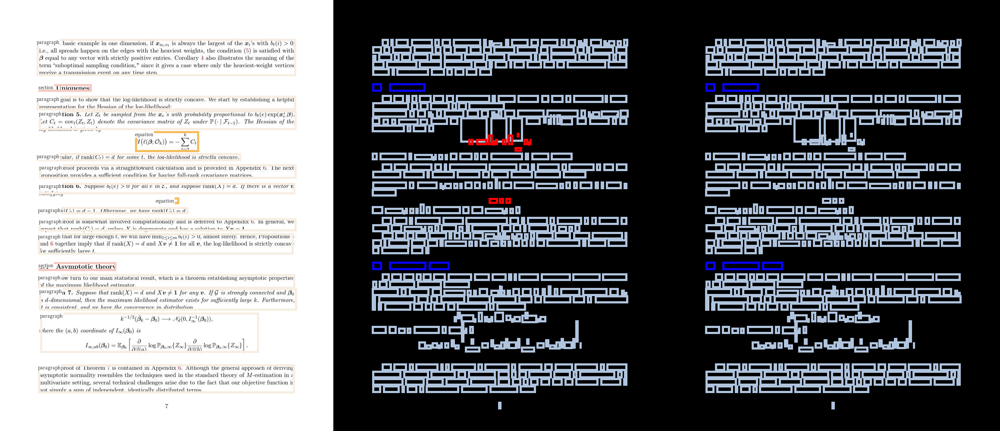

In [20]:
_cvt_label = {int(key):val for key, val in grouped['labels'].items()}
_names = []
_num_tokens = []
for idx in random.sample(range(len(all_files)), 20):
    print(all_files[idx].replace('.txt',''))
    _names.append(all_files[idx].replace('.txt',''))


    i = dataset.all_index.index(all_files[idx].replace('.txt',''))

    name, layout, image = dataset[i]
    block_layout = lp.Layout(blocks[blocks.file_id == files.loc[name].iloc[0]].apply(convert_row_to_rectbox, axis=1).to_list())
    block_layout = block_layout.scale((image.size[0]/1000, image.size[1]/1000))
    
    idx = grouped['files'].index(all_files[idx])
    p = grouped['data'][idx]
    grouped_layout = [lp.TextBlock(lp.Rectangle(*p['bbox'][i]), text=p['words'][i], type=_cvt_label[p['labels'][i]]) for i in range(len(grouped['data'][idx]['words']))]    
    grouped_layout = lp.Layout(grouped_layout).scale((image.size[0]/1000, image.size[1]/1000))
    
    viz = lp.draw_box(Image.new('RGB', (image.size[0]*2, image.size[1])), 
                      grouped_layout, color_map=UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP)
    viz = lp.draw_box(viz, [ele.shift((image.size[0],0)) for ele in layout], color_map=UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP)
    
    viz = Image.fromarray(np.hstack([np.array(image), np.array(viz)]))
    viz = lp.draw_box(viz, [ele.set(id=ele.type) for ele in block_layout], show_element_id=True, id_font_size=10)
    
    _num_tokens.append(len(layout))
    print("Original + Blocks\t\t\t\t" + "After Processing \t\t\t\t" + "Original")
    display(viz)

In [23]:
# Load the processed dataset 

subset = 'dev'
with open(f"data/DocBank/grouped-v3.1/{subset}-token.json", "r") as fp: 
    grouped = json.load(fp)
    
with open(f"data/DocBank/indexed_files/500K_{subset}.txt", "r") as fp:
    all_files = fp.read()
    all_files = all_files.strip().split("\n")

75.tar_1406.4242.gz_SUPER4_12
Original + Blocks				After Processing 				Original


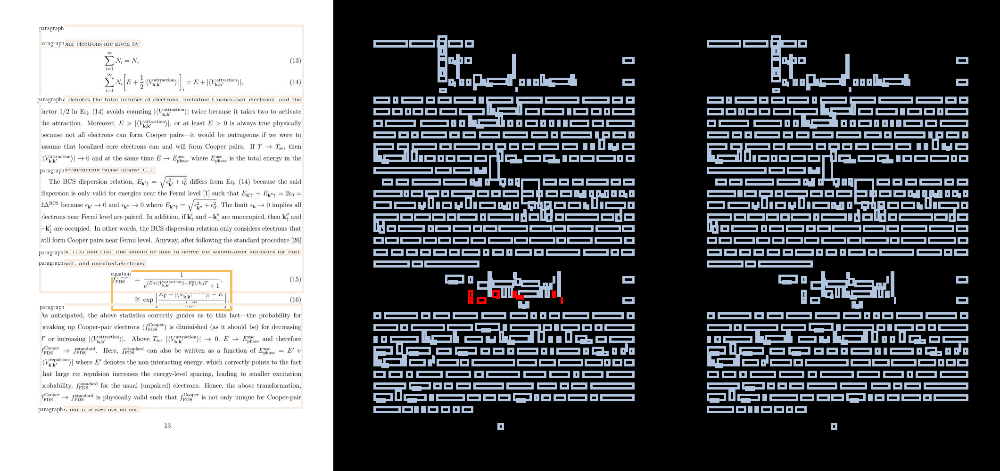

9.tar_1401.5684.gz_ccm_5
Original + Blocks				After Processing 				Original


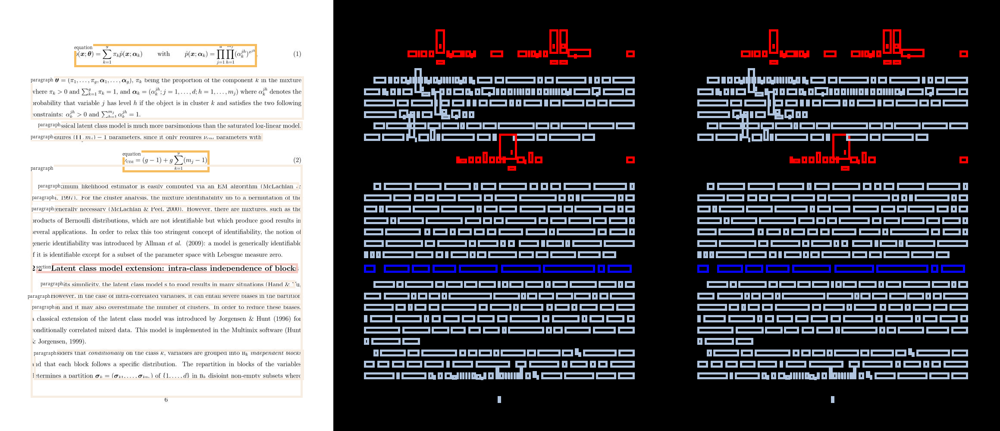

12.tar_1401.7641.gz_Frenkel_Electron_Inter_HEPTH_4
Original + Blocks				After Processing 				Original


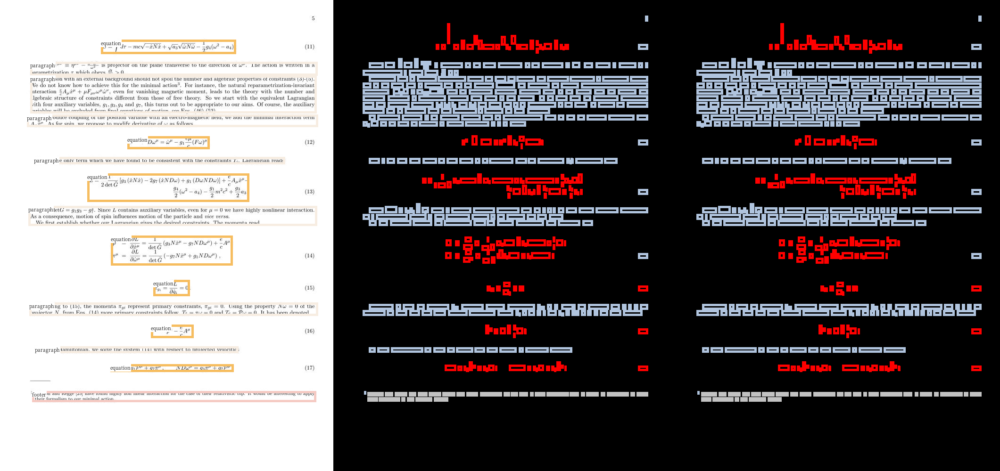

204.tar_1610.07628.gz_TQFT_MergeTex_7
Original + Blocks				After Processing 				Original


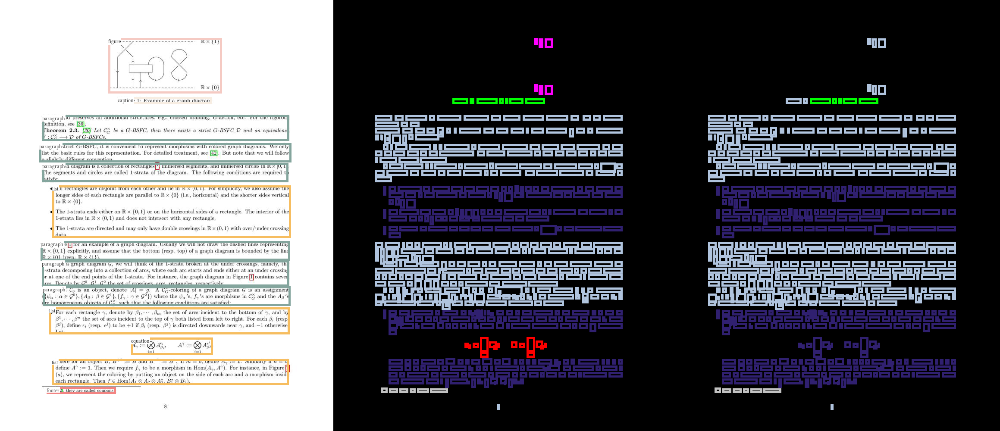

93.tar_1605.06326.gz_litRev_41
Original + Blocks				After Processing 				Original


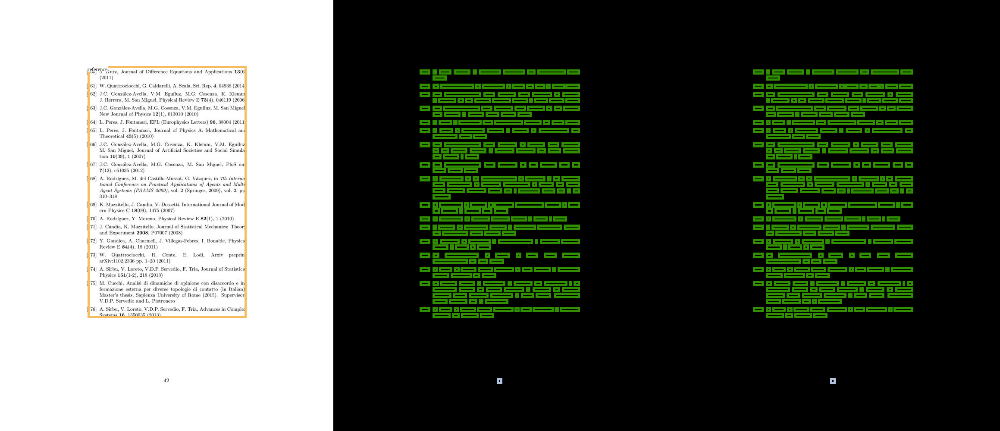

8.tar_1801.03393.gz_Viktor_Ariel_Quaternion_Relativity_2018-01-05_2
Original + Blocks				After Processing 				Original


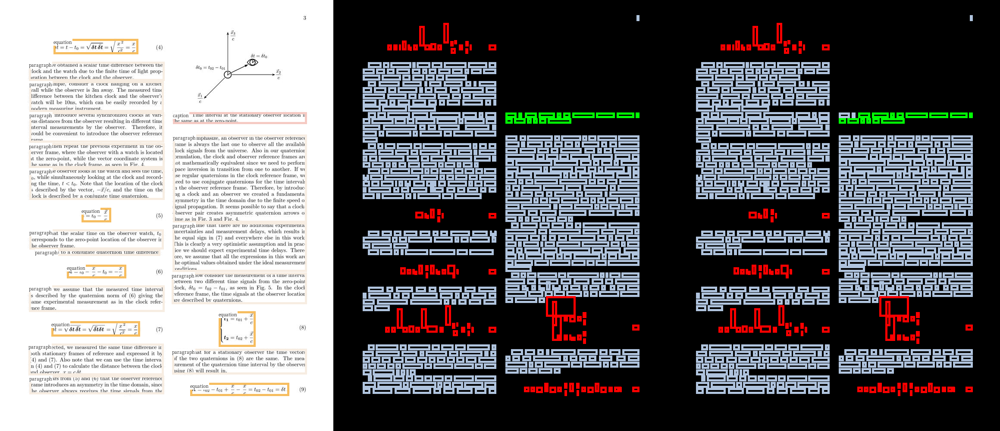

254.tar_1612.08453.gz_q13_2
Original + Blocks				After Processing 				Original


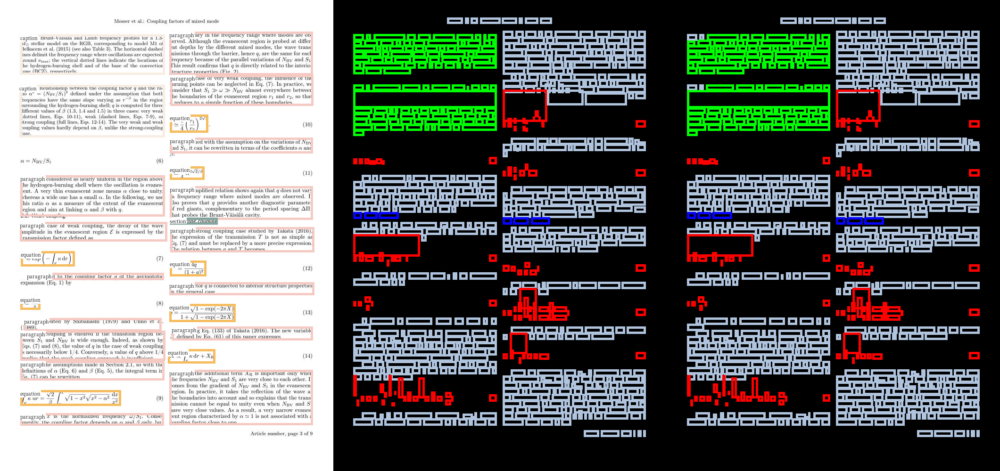

22.tar_1502.03119.gz_atiyah-dg-arxiv_5
Original + Blocks				After Processing 				Original


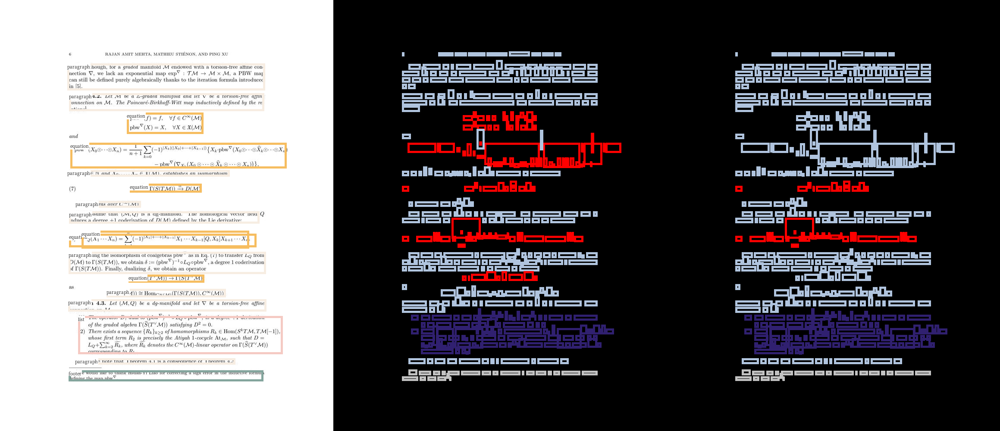

177.tar_1511.01167.gz_paper_32
Original + Blocks				After Processing 				Original


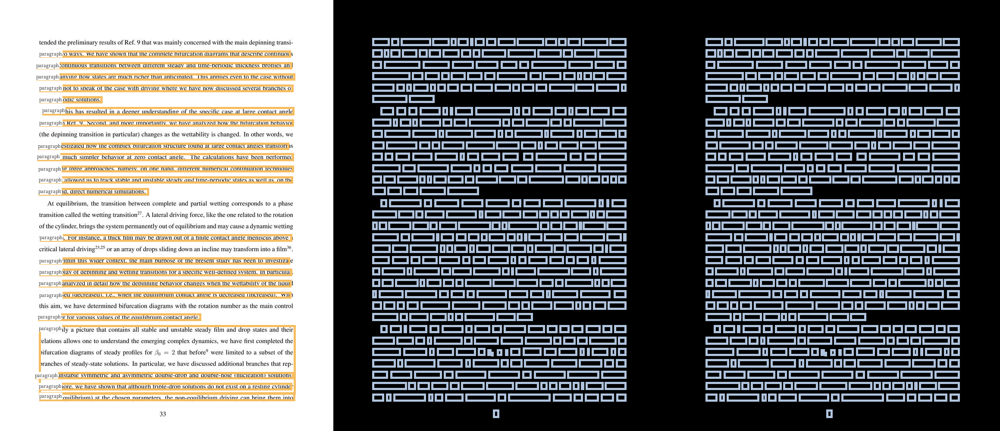

238.tar_1808.06123.gz_low-energy_31
Original + Blocks				After Processing 				Original


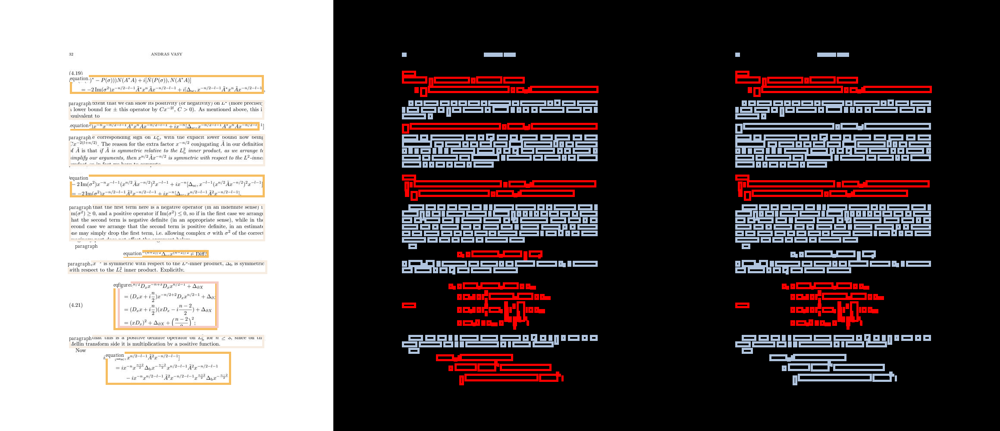

288.tar_1712.03524.gz_main_2
Original + Blocks				After Processing 				Original


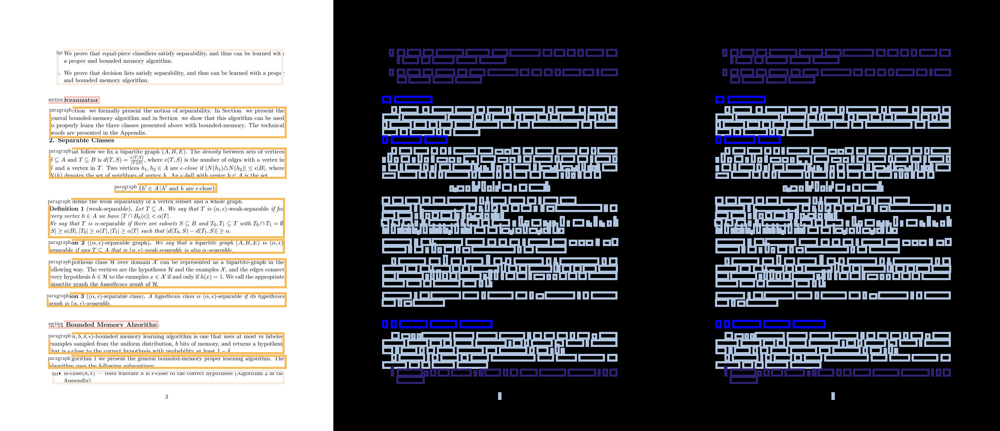

29.tar_1602.05816.gz_J1753_2016a.FINAL_1
Original + Blocks				After Processing 				Original


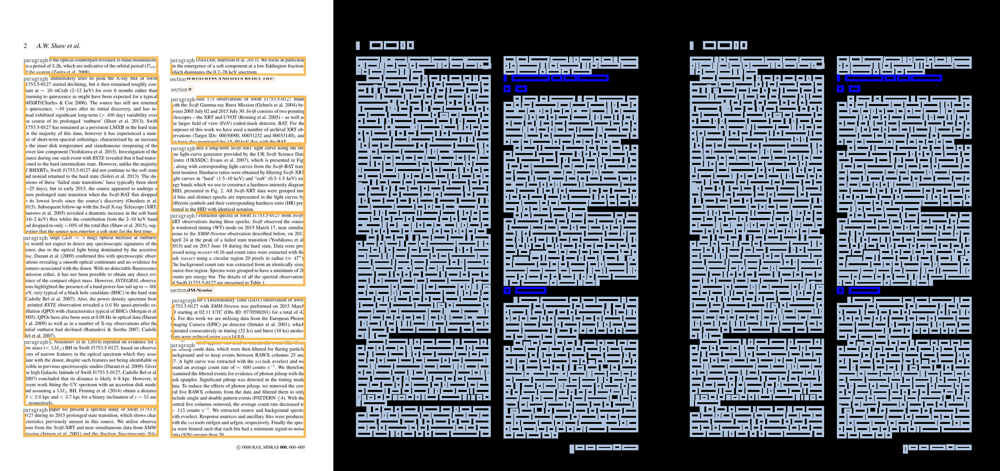

124.tar_1409.7510.gz_article_10
Original + Blocks				After Processing 				Original


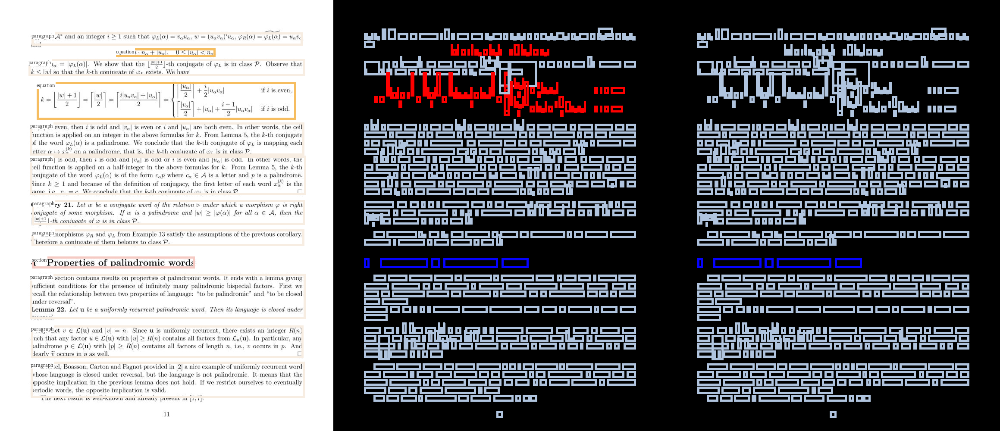

161.tar_1510.02872.gz_151231-DuanLongWang_18
Original + Blocks				After Processing 				Original


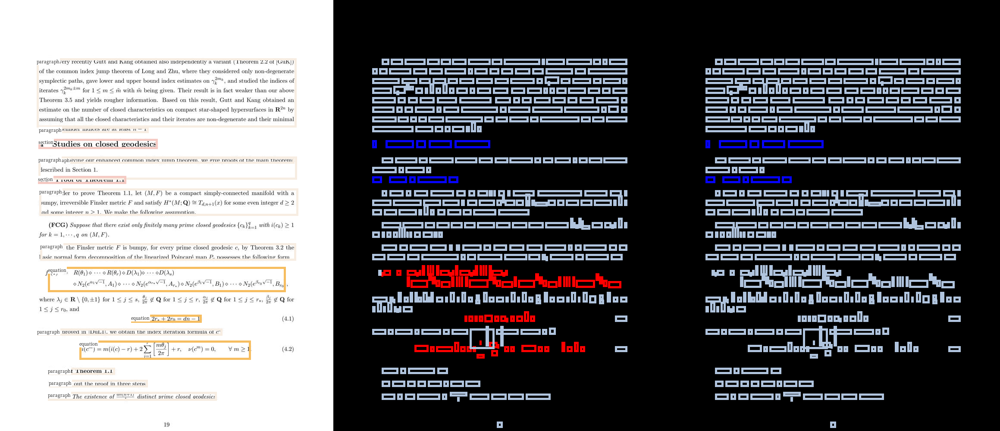

173.tar_1708.01966.gz_Mwn_1
Original + Blocks				After Processing 				Original


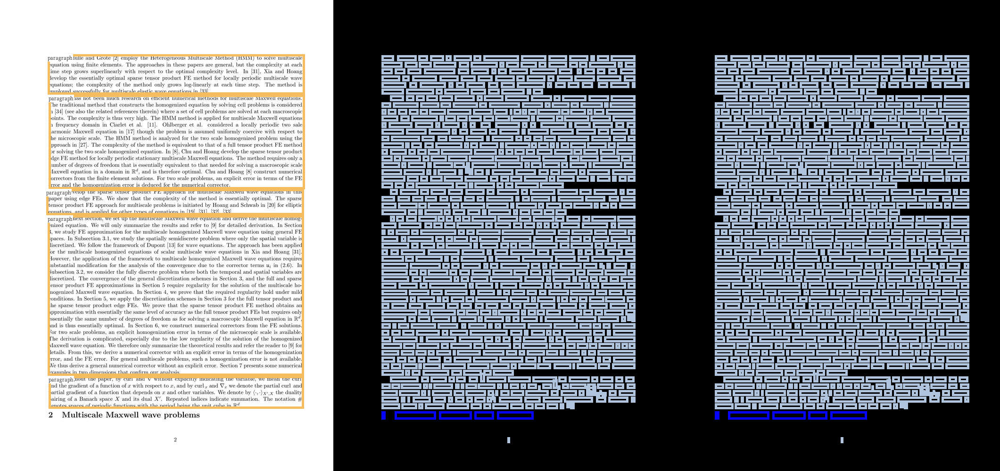

123.tar_1606.09424.gz_ShapleyVarianceArXiv20170101_2
Original + Blocks				After Processing 				Original


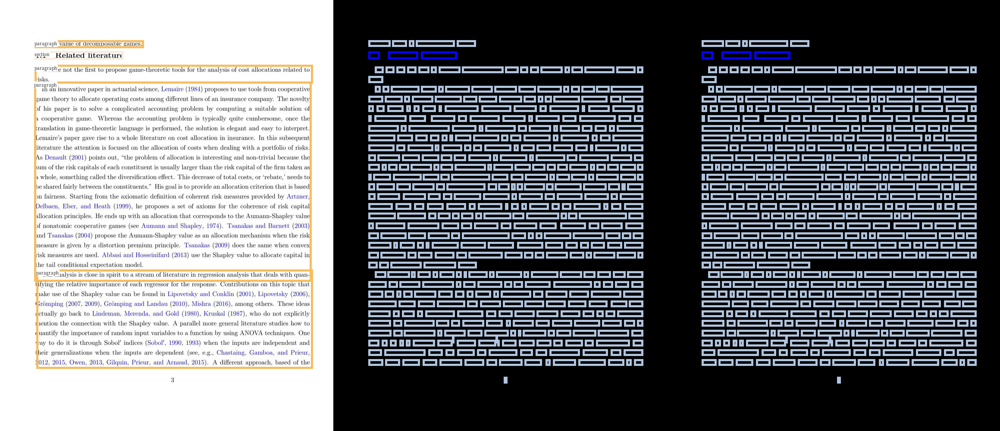

25.tar_1801.10088.gz_SPDE_Systemic_Risk_Contagion_28
Original + Blocks				After Processing 				Original


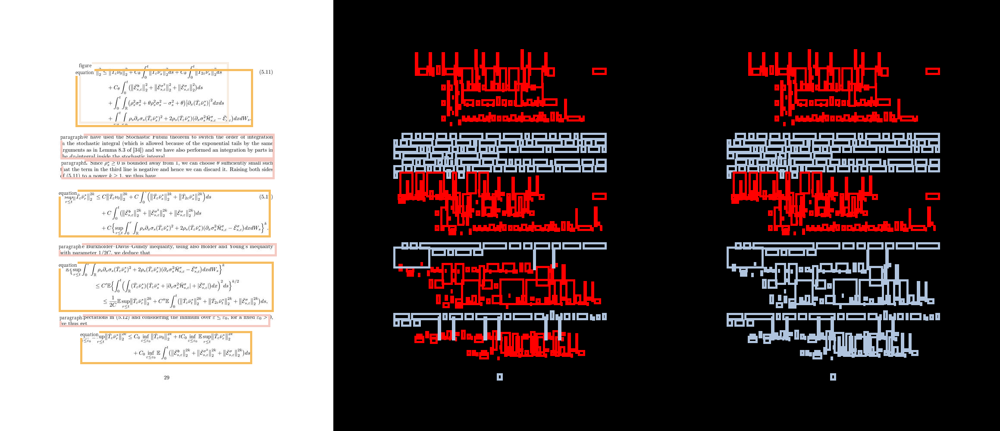

106.tar_1408.4951.gz_spbfull15_33
Original + Blocks				After Processing 				Original


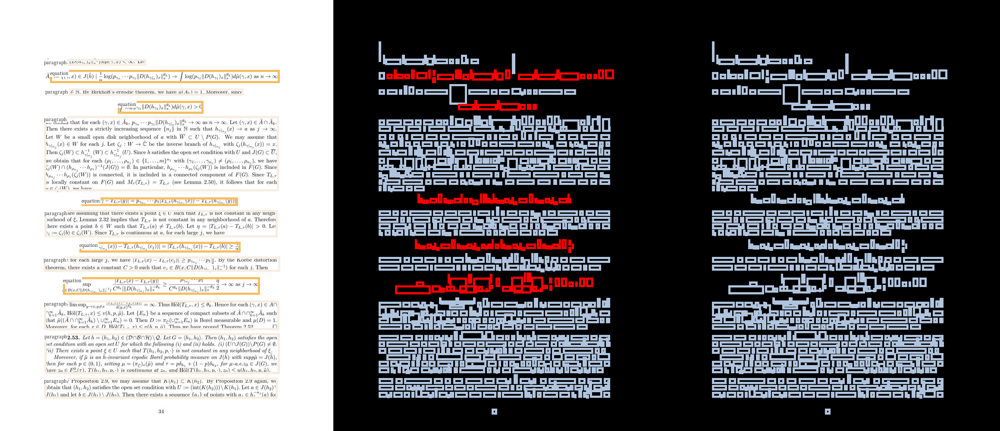

22.tar_1702.00228.gz_coll-modes-2_9
Original + Blocks				After Processing 				Original


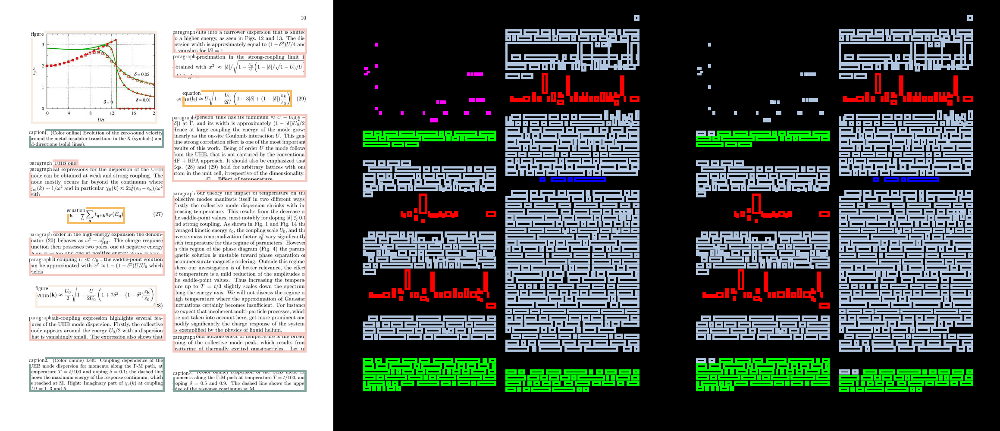

196.tar_1610.03592.gz_Pap8full_6
Original + Blocks				After Processing 				Original


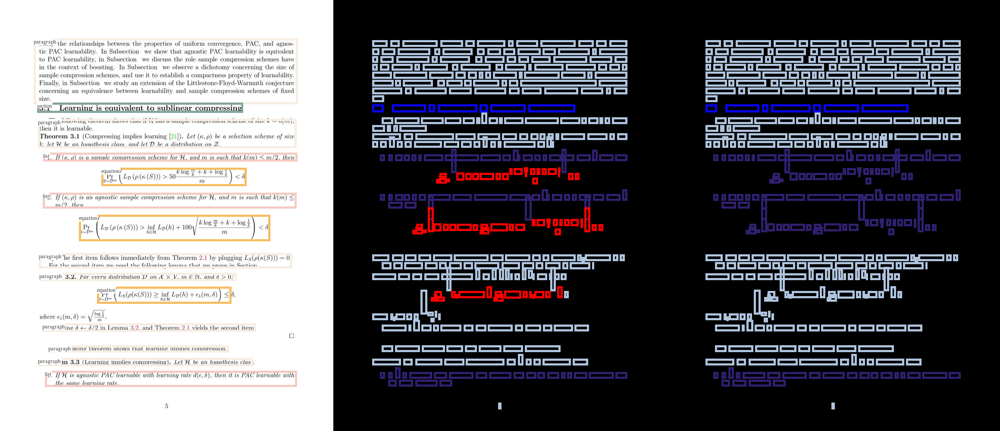

In [24]:
_cvt_label = {int(key):val for key, val in grouped['labels'].items()}
_names = []
_num_tokens = []
for idx in random.sample(range(len(all_files)), 20):
    print(all_files[idx].replace('.txt',''))
    _names.append(all_files[idx].replace('.txt',''))


    i = dataset.all_index.index(all_files[idx].replace('.txt',''))

    name, layout, image = dataset[i]
    block_layout = lp.Layout(blocks[blocks.file_id == files.loc[name].iloc[0]].apply(convert_row_to_rectbox, axis=1).to_list())
    block_layout = block_layout.scale((image.size[0]/1000, image.size[1]/1000))
    
    idx = grouped['files'].index(all_files[idx])
    p = grouped['data'][idx]
    grouped_layout = [lp.TextBlock(lp.Rectangle(*p['bbox'][i]), text=p['words'][i], type=_cvt_label[p['labels'][i]]) for i in range(len(grouped['data'][idx]['words']))]    
    grouped_layout = lp.Layout(grouped_layout).scale((image.size[0]/1000, image.size[1]/1000))
    
    viz = lp.draw_box(Image.new('RGB', (image.size[0]*2, image.size[1])), 
                      grouped_layout, color_map=UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP)
    viz = lp.draw_box(viz, [ele.shift((image.size[0],0)) for ele in layout], color_map=UNIVERSAL_LAYOUT_ELEMENT_COLOR_MAP)
    
    viz = Image.fromarray(np.hstack([np.array(image), np.array(viz)]))
    viz = lp.draw_box(viz, [ele.set(id=ele.type) for ele in block_layout], show_element_id=True, id_font_size=10)
    
    _num_tokens.append(len(layout))
    print("Original + Blocks\t\t\t\t" + "After Processing \t\t\t\t" + "Original")
    display(viz)

In [ ]:
# print("\n".join(_names))

# for ele in _num_tokens: print(ele)